# Final Project: Decision Trees vs. Support Vector Machines

#### Project name: Star Classification
#### Author: Qichun Yu

##### This project aims to classify galaxies, quasars(QSO), and stars based on their spectral characteristics. Decision Trees and Support Vector Machine (SVM) are used for classification purposes in this notebook. 

- Definitions from Wikipedia: <br>
 - A star is an astronomical object comprising a luminous spheroid of plasma held together by its gravity. 
 - A galaxy is a gravitationally bound system of stars, stellar remnants, interstellar gas, dust, and dark matter.
 - A quasar (also known as a quasi-stellar object, abbreviated QSO) is an extremely luminous active galactic nucleus (AGN), powered by a supermassive black hole, with mass ranging from millions to tens of billions of solar masses, surrounded by a gaseous accretion disc. 
<br>
- Retrieved from https://en.wikipedia.org/wiki/

### Content
The data consists of 100,000 observations of space taken by the SDSS (Sloan Digital Sky Survey). Every observation is described by 17 feature columns and 1 class column which identifies it to be either a star, galaxy or quasar.
<ol>
    <li>obj_ID = Object Identifier, the unique value that identifies the object in the image catalog used by the CAS</li>
    <li>alpha = Right Ascension angle (at J2000 epoch)</li>
    <li>delta = Declination angle (at J2000 epoch)</li>
    <li>u = Ultraviolet filter in the photometric system</li>
    <li>g = Green filter in the photometric system</li>
    <li>r = Red filter in the photometric system</li>
    <li>i = Near Infrared filter in the photometric system</li>
    <li>z = Infrared filter in the photometric system</li>
    <li>run_ID = Run Number used to identify the specific scan</li>
    <li>rereun_ID = Rerun Number to specify how the image was processed</li>
    <li>cam_col = Camera column to identify the scanline within the run</li>
    <li>field_ID = Field number to identify each field</li>
    <li>spec_obj_ID = Unique ID used for optical spectroscopic objects (this means that 2 different observations with the same spec_obj_ID must share the output class)</li>
    <li>class = object class (galaxy, star or quasar object)</li>
    <li>redshift = redshift value based on the increase in wavelength</li>
    <li>plate = plate ID, identifies each plate in SDSS</li>
    <li>MJD = Modified Julian Date, used to indicate when a given piece of SDSS data was taken</li>
    <li>fiber_ID = fiber ID that identifies the fiber that pointed the light at the focal plane in each observation</li>
</ol>

## Citation

fedesoriano. (January 2022). Stellar Classification Dataset - SDSS17. Retrieved from https://www.kaggle.com/fedesoriano/stellar-classification-dataset-sdss17.

## Import Modules

In [1]:
import pandas as pd
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
import utils9
from sklearn import model_selection as ms
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

## Load and Read Data

In [2]:
data = pd.read_csv("star_classification.csv")
data

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,class,redshift,plate,MJD,fiber_ID
0,1.237661e+18,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,301,2,79,6.543777e+18,GALAXY,0.634794,5812,56354,171
1,1.237665e+18,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,301,5,119,1.176014e+19,GALAXY,0.779136,10445,58158,427
2,1.237661e+18,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,301,2,120,5.152200e+18,GALAXY,0.644195,4576,55592,299
3,1.237663e+18,338.741038,-0.402828,22.13682,23.77656,21.61162,20.50454,19.25010,4192,301,3,214,1.030107e+19,GALAXY,0.932346,9149,58039,775
4,1.237680e+18,345.282593,21.183866,19.43718,17.58028,16.49747,15.97711,15.54461,8102,301,3,137,6.891865e+18,GALAXY,0.116123,6121,56187,842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,1.237679e+18,39.620709,-2.594074,22.16759,22.97586,21.90404,21.30548,20.73569,7778,301,2,581,1.055431e+19,GALAXY,0.000000,9374,57749,438
99996,1.237679e+18,29.493819,19.798874,22.69118,22.38628,20.45003,19.75759,19.41526,7917,301,1,289,8.586351e+18,GALAXY,0.404895,7626,56934,866
99997,1.237668e+18,224.587407,15.700707,21.16916,19.26997,18.20428,17.69034,17.35221,5314,301,4,308,3.112008e+18,GALAXY,0.143366,2764,54535,74
99998,1.237661e+18,212.268621,46.660365,25.35039,21.63757,19.91386,19.07254,18.62482,3650,301,4,131,7.601080e+18,GALAXY,0.455040,6751,56368,470


In [3]:
data['class'].value_counts()

GALAXY    59445
STAR      21594
QSO       18961
Name: class, dtype: int64

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 18 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   obj_ID       100000 non-null  float64
 1   alpha        100000 non-null  float64
 2   delta        100000 non-null  float64
 3   u            100000 non-null  float64
 4   g            100000 non-null  float64
 5   r            100000 non-null  float64
 6   i            100000 non-null  float64
 7   z            100000 non-null  float64
 8   run_ID       100000 non-null  int64  
 9   rerun_ID     100000 non-null  int64  
 10  cam_col      100000 non-null  int64  
 11  field_ID     100000 non-null  int64  
 12  spec_obj_ID  100000 non-null  float64
 13  class        100000 non-null  object 
 14  redshift     100000 non-null  float64
 15  plate        100000 non-null  int64  
 16  MJD          100000 non-null  int64  
 17  fiber_ID     100000 non-null  int64  
dtypes: float64(10), int64(7),

Noticed that all features other than class are numeric data. 

In [6]:
data.describe()

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,redshift,plate,MJD,fiber_ID
count,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.0,100000.000000,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000
mean,1.237665e+18,177.629117,24.135305,21.980468,20.531387,19.645762,19.084854,18.668810,4481.366060,301.0,3.511610,186.130520,5.783882e+18,0.576661,5137.009660,55588.647500,449.312740
std,8.438560e+12,96.502241,19.644665,31.769291,31.750292,1.854760,1.757895,31.728152,1964.764593,0.0,1.586912,149.011073,3.324016e+18,0.730707,2952.303351,1808.484233,272.498404
min,1.237646e+18,0.005528,-18.785328,-9999.000000,-9999.000000,9.822070,9.469903,-9999.000000,109.000000,301.0,1.000000,11.000000,2.995191e+17,-0.009971,266.000000,51608.000000,1.000000
25%,1.237659e+18,127.518222,5.146771,20.352353,18.965230,18.135828,17.732285,17.460677,3187.000000,301.0,2.000000,82.000000,2.844138e+18,0.054517,2526.000000,54234.000000,221.000000
50%,1.237663e+18,180.900700,23.645922,22.179135,21.099835,20.125290,19.405145,19.004595,4188.000000,301.0,4.000000,146.000000,5.614883e+18,0.424173,4987.000000,55868.500000,433.000000
75%,1.237668e+18,233.895005,39.901550,23.687440,22.123767,21.044785,20.396495,19.921120,5326.000000,301.0,5.000000,241.000000,8.332144e+18,0.704154,7400.250000,56777.000000,645.000000
max,1.237681e+18,359.999810,83.000519,32.781390,31.602240,29.571860,32.141470,29.383740,8162.000000,301.0,6.000000,989.000000,1.412694e+19,7.011245,12547.000000,58932.000000,1000.000000


In [7]:
data.corr()

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,redshift,plate,MJD,fiber_ID
obj_ID,1.000000,-0.013735,-0.301237,0.015310,0.015710,0.153891,0.147670,0.013811,1.000000,NaN,-0.046997,0.031498,0.239461,0.065400,0.239460,0.262687,0.067178
alpha,-0.013735,1.000000,0.138691,-0.001532,-0.002423,-0.022083,-0.023580,-0.002918,-0.013737,NaN,0.019582,-0.165577,-0.002553,0.001667,-0.002554,0.019943,0.030464
delta,-0.301237,0.138691,1.000000,0.002074,0.003523,-0.006835,-0.004480,0.003630,-0.301238,NaN,0.032565,-0.173416,0.112329,0.031638,0.112329,0.107333,0.028250
u,0.015310,-0.001532,0.002074,1.000000,0.999311,0.054149,0.045730,0.998093,0.015309,NaN,0.003548,-0.008374,0.029997,0.014309,0.029997,0.031997,0.016305
g,0.015710,-0.002423,0.003523,0.999311,1.000000,0.062387,0.056271,0.999161,0.015710,NaN,0.003508,-0.008852,0.039443,0.022954,0.039443,0.040274,0.017470
r,0.153891,-0.022083,-0.006835,0.054149,0.062387,1.000000,0.962868,0.053677,0.153889,NaN,0.008480,-0.026423,0.655245,0.433241,0.655243,0.671180,0.223106
i,0.147670,-0.023580,-0.004480,0.045730,0.056271,0.962868,1.000000,0.055994,0.147668,NaN,0.007615,-0.026679,0.661641,0.492383,0.661640,0.672523,0.214787
z,0.013811,-0.002918,0.003630,0.998093,0.999161,0.053677,0.055994,1.000000,0.013811,NaN,0.003365,-0.008903,0.037813,0.030380,0.037813,0.037469,0.014668
run_ID,1.000000,-0.013737,-0.301238,0.015309,0.015710,0.153889,0.147668,0.013811,1.000000,NaN,-0.047098,0.031498,0.239460,0.065400,0.239459,0.262687,0.067165
rerun_ID,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


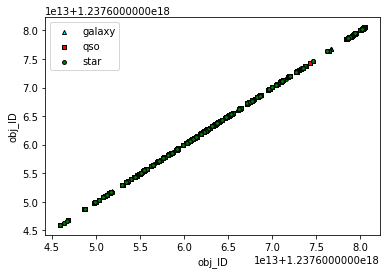

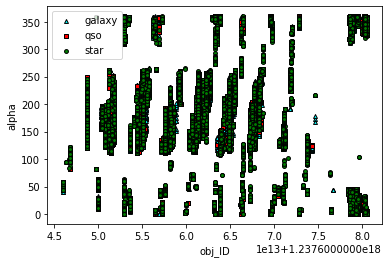

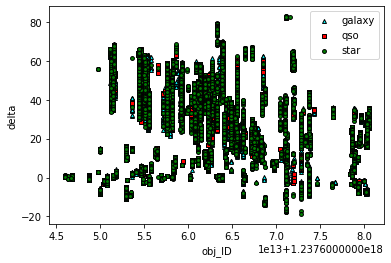

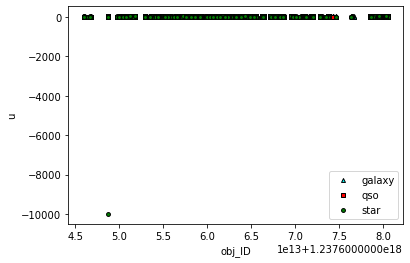

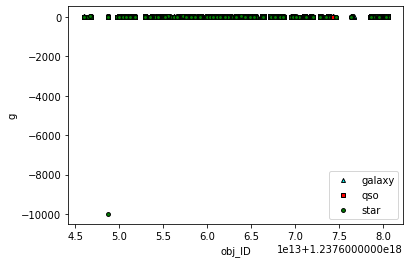

...

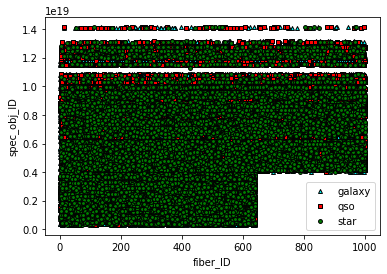

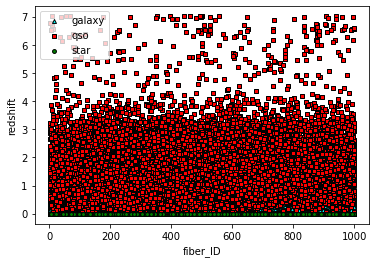

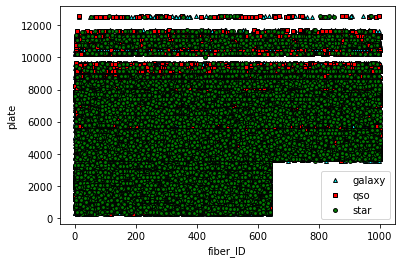

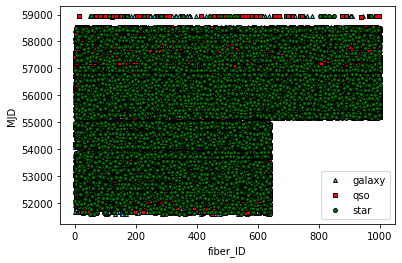

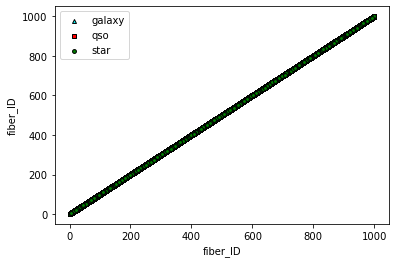

In [8]:
features = list(data.drop(['class'], axis=1).columns)
for i in features:
    for j in features:
        utils9.plot_points(data[[i, j]], data['class'], size_of_points=15)


## Data Cleaning

##### There is no null value from the dataset. 

In [9]:
data.isnull().values.any()

False

##### obj_ID = Object Identifier, the unique value that identifies the object in the image catalog used by the CAS<br><br>The obj_ID is object identifier, which is unique for each individual. The unique id does not help to classify the stellar, so can be dropped from the dataset. 

In [10]:
data = data.drop(['obj_ID'], axis=1)

##### The rerun_ID is the rerun number to specify how the image was processed, and it is always 301 for all rows, so dropped from the data can be a good choice. 

In [11]:
#nunique is a panda function to help count number of distinct elements in specified axis
data['rerun_ID'].nunique()

1

In [12]:
data = data.drop(['rerun_ID'], axis=1)

#### The spec_obj_ID is the Unique ID used for optical spectroscopic objects, it is an unique number for each individual so it can be dropped from the data. 

In [13]:
data['spec_obj_ID'].nunique()

100000

In [14]:
data = data.drop(['spec_obj_ID'], axis=1)

#### The cam_col is Camera column to identify the scanline within the run. 

In [15]:
data['cam_col'].nunique()

6

There are six different class of cam_col. 

In [16]:
data['cam_col'].value_counts()

4    19573
3    18851
5    18537
2    17117
1    13227
6    12695
Name: cam_col, dtype: int64

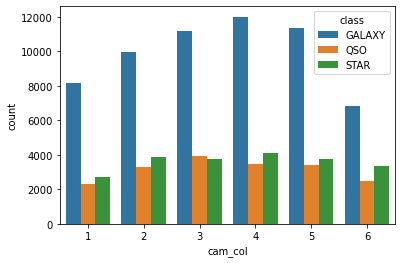

In [17]:
sns.countplot(x=data['cam_col'], hue=data['class']);

Noticed that from the seaborn countplot graph above, classify the class based on the cam_col is hard since each class of cam_col have almost similar distribution for each stat class. None of the class of cam_col have more class of galaxy or QSO or star. Therefore, we should drop the "cam_col" column from the dataset.  

In [18]:
data = data.drop(['cam_col'], axis=1)

In [19]:
data

,alpha,delta,u,g,r,i,z,run_ID,field_ID,class,redshift,plate,MJD,fiber_ID
0,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,79,GALAXY,0.634794,5812,56354,171
1,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,119,GALAXY,0.779136,10445,58158,427
2,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,120,GALAXY,0.644195,4576,55592,299
3,338.741038,-0.402828,22.13682,23.77656,21.61162,20.50454,19.25010,4192,214,GALAXY,0.932346,9149,58039,775
4,345.282593,21.183866,19.43718,17.58028,16.49747,15.97711,15.54461,8102,137,GALAXY,0.116123,6121,56187,842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,39.620709,-2.594074,22.16759,22.97586,21.90404,21.30548,20.73569,7778,581,GALAXY,0.000000,9374,57749,438
99996,29.493819,19.798874,22.69118,22.38628,20.45003,19.75759,19.41526,7917,289,GALAXY,0.404895,7626,56934,866
99997,224.587407,15.700707,21.16916,19.26997,18.20428,17.69034,17.35221,5314,308,GALAXY,0.143366,2764,54535,74
99998,212.268621,46.660365,25.35039,21.63757,19.91386,19.07254,18.62482,3650,131,GALAXY,0.455040,6751,56368,470


In [20]:
x = data.drop(['class'], axis=1)
y = data['class']

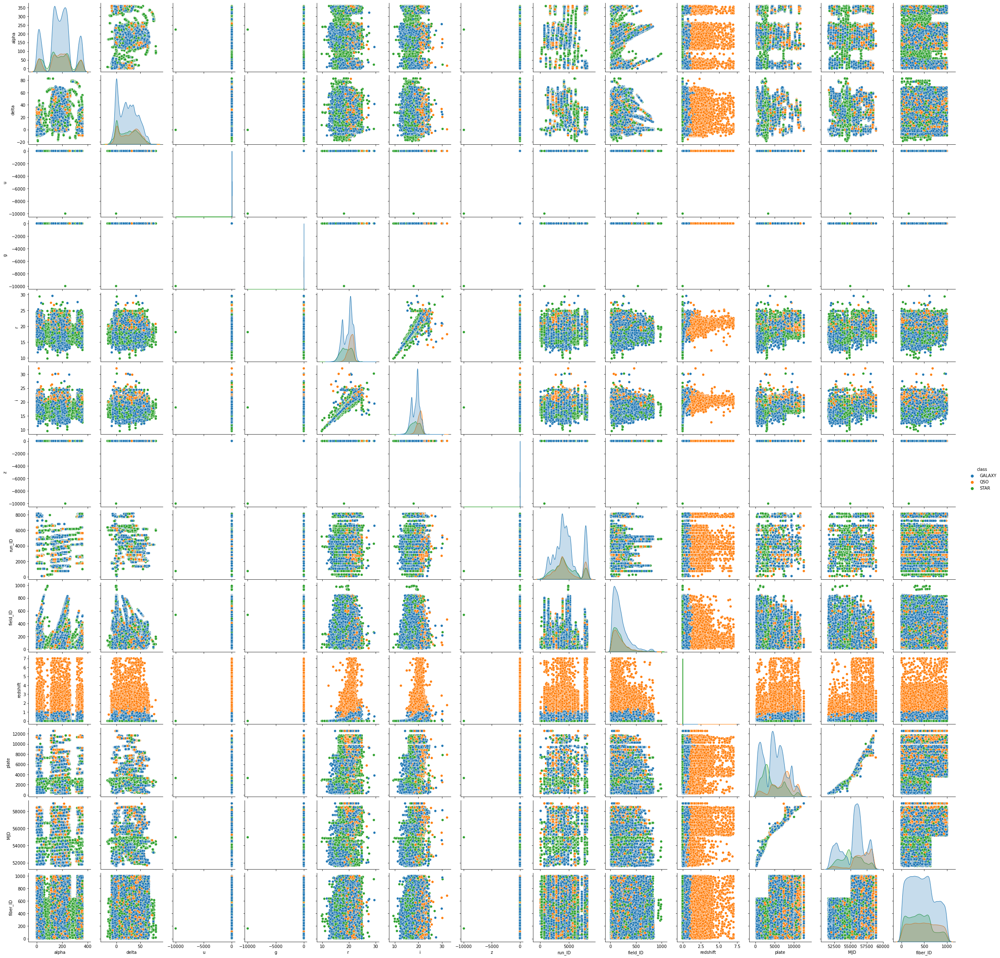

In [75]:
sns.pairplot(data, hue='class')

## Data Split

In [21]:
#Training/Validation/Testing Split: 60, 20, 20
x_train, x_test, y_train, y_test = ms.train_test_split(x, y, test_size=0.4, random_state=0)
x_test, x_valid, y_test, y_valid = ms.train_test_split(x_test, y_test, test_size=0.5, random_state=0)

#Training/Validation/Testing Split: 80, 10, 10
#x_train, x_test, y_train, y_test = ms.train_test_split(x, y, test_size=0.2, random_state=0)
#x_test, x_valid, y_test, y_valid = ms.train_test_split(x_test, y_test, test_size=0.5, random_state=0)

### After trying different training/validation/testing split ratios, I found that the performance is similar with a 60/20/20 split and an 80/10/10. If the size of data is small, choosing a high ratio for training can help improve the performance of the model. However, the dataset contains 100,000 examples, 60% of the data for training is large enough to make a good prediction. 60/20/20 for training/validation/testing will split data to 60,000 for training, 20,000 for validation, and 20,000 for testing. The data are large enough for training and validating for over-fitting or underfitting issues. 

In [22]:
x_train

,alpha,delta,u,g,r,i,z,run_ID,field_ID,redshift,plate,MJD,fiber_ID
81136,8.087338,13.876625,23.99474,21.77333,20.68571,20.22289,20.16610,2566,361,-0.001724,417,51821,89
79804,346.948311,25.684002,22.65701,21.27622,21.02466,20.81724,20.35891,6354,160,2.329490,7705,57332,780
34903,215.627682,-2.932710,23.88090,22.81277,21.26676,19.95775,19.32905,2379,43,0.619211,4032,55333,251
63752,140.564482,39.294267,24.76478,22.00012,20.19444,19.38463,18.92471,2964,103,0.483410,4642,55926,713
51129,216.560824,19.117920,19.32651,17.35555,16.42559,16.02594,15.72050,5194,662,0.076885,2773,54533,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...
21243,178.659485,22.213454,23.02713,21.79717,20.15561,19.21565,18.74604,5183,310,0.479940,6423,56313,63
45891,231.520274,18.764341,20.39821,18.49582,17.39976,16.88339,16.45156,4670,226,0.108567,2159,54328,13
42613,334.856082,0.077762,18.97330,17.87081,17.44646,17.29562,17.20019,4192,188,-0.000550,1144,53238,432
43567,200.820199,65.272106,19.70816,18.40767,17.58343,17.22796,17.01092,1302,420,0.165433,603,52056,364


# Decision tree

## Building a decision tree using gini

In [23]:
dt = DecisionTreeClassifier()

In [24]:
dt.fit(x_train, y_train)

DecisionTreeClassifier()

In [25]:
dt.predict(x_train[0:5])

array(['STAR', 'QSO', 'GALAXY', 'GALAXY', 'GALAXY'], dtype=object)

In [26]:
print("Training accuracy:", dt.score(x_train, y_train))

Training accuracy: 1.0


In [27]:
print("Validation accuracy:", dt.score(x_valid, y_valid))

Validation accuracy: 0.96565


In [28]:
utils9.display_tree(dt)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.49491 to fit



In [29]:
y_pred = dt.predict(x_test)
print("Testing accuracy:",accuracy_score(y_test,y_pred))

Testing accuracy: 0.9648


In [30]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

      GALAXY       0.97      0.97      0.97     11797
         QSO       0.91      0.92      0.91      3826
        STAR       1.00      0.99      0.99      4377

    accuracy                           0.96     20000
   macro avg       0.96      0.96      0.96     20000
weighted avg       0.96      0.96      0.96     20000



The classification report is a performance evaluation metric that is used to show the precision, recall, F1 Score, and support score on a per-class basis. Precision is the ratio of true positives to the sum of true and false positives. It gives what percent of the predictions were correct for each class. The recall is the ratio of true positives to the sum of true positives and false negatives. The recall shows the percent of the positive cases that the model catch. The F1 is the weighted harmonic mean of precision & recall. From the classification report, noticed that all of the scores are higher than 90%, which is good. If we compared with f1-score with each class. The STAR has the highest value with 99%. The model seems to have less performance on classifying QSO compared with others. The average f1-score is 96%, which is good. 

<AxesSubplot:>

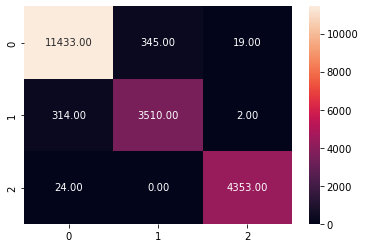

In [31]:
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt=".2f")

Confusion matrix diagonal each element with the correct prediction. When predicting the galaxy, there are 11,433 predicted as the galaxy but from the actual data there are 11,771. QSO has the worst errors. When predicting QSO, it predicted 3510 of it as the QSO when the actually is QSO. However, it predict 314 as QSO when the actual data was galaxy and 2 of it when the actual data was Star. 

## Building a decision tree using entropy

In [32]:
dt_entropy = DecisionTreeClassifier(criterion='entropy')
dt_entropy.fit(x_train, y_train)
print("Training accuracy:", dt_entropy.score(x_train, y_train))

Training accuracy: 1.0


In [33]:
print("Validation accuracy:", dt_entropy.score(x_valid, y_valid))

Validation accuracy: 0.96485


In [34]:
utils9.display_tree(dt_entropy)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.520169 to fit



In [35]:
y_pred = dt_entropy.predict(x_test)
print("Testing accuracy: ",accuracy_score(y_test,y_pred))

Testing accuracy:  0.96625


In [36]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

      GALAXY       0.97      0.97      0.97     11797
         QSO       0.91      0.92      0.92      3826
        STAR       1.00      1.00      1.00      4377

    accuracy                           0.97     20000
   macro avg       0.96      0.96      0.96     20000
weighted avg       0.97      0.97      0.97     20000



## Hyperparameters control

- max_depth: Determines the maximum allowed depth of the tree. The depth of the tree is the maximum distance between the root and any leaf. The default value is set to none, which may result in over-fitting.
- max_features: It sets the maximum number of features to consider at each time to make the split decision. Without the setting of this hyperparameter, the decision tree training will consider all features that are available in the dataset. It can help reduce training process time when the dataset contains too many features. 
- min_impurity_decrease: The decision tree will stop growing if any split reaches the min_impurity_decrease. The decrease in impurity must be higher than the setting of min_impurity_decrease to split a node. 
- min_impurity_split: The node becomes a leaf when the impurity at a node is less than this hyperparameter. For example, if the min_impurity_split is set to be 0.2, the Gini value must be higher than 0.2 to be further split. 
- min_samples_leaf: Specifies the minimum number of samples required for an external(without child branches) node. The split will not happen when a split has less than the minimum number required for the samples. 
- min_samples_split: Specifies the minimum number of samples required to split an internal(with child branches) node. 

#### Training a smaller tree with max_depth=4, min_samples_leaf=10, min_samples_split=10

In [37]:
dt_1 = DecisionTreeClassifier(max_depth=4, min_samples_leaf=10, min_samples_split=10)
dt_1.fit(x_train, y_train)
print("Training accuracy:", dt_1.score(x_train, y_train))

Training accuracy: 0.9655166666666667


In [38]:
print("Validation accuracy:", dt_1.score(x_valid, y_valid))

Validation accuracy: 0.96565


In [39]:
y_pred_1 = dt_1.predict(x_test)
print("Testing Accuracy:",accuracy_score(y_test,y_pred_1))

Testing Accuracy: 0.96535


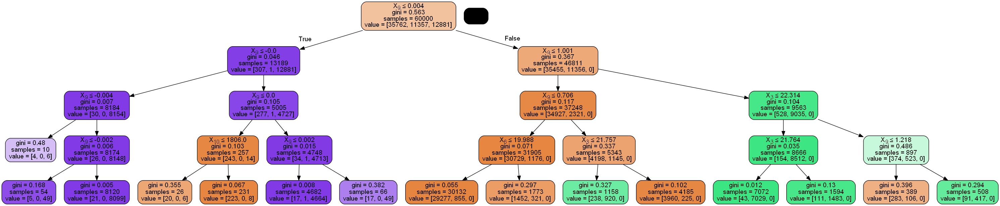

In [40]:
utils9.display_tree(dt_1)

#### Training a smaller tree with max_depth=5, min_samples_leaf=10, min_samples_split=10

In [41]:
dt_2 = DecisionTreeClassifier(max_depth=5, min_samples_leaf=10, min_samples_split=10)
dt_2.fit(x_train, y_train)
print("Training accuracy:", dt_2.score(x_train, y_train))

Training accuracy: 0.96585


In [42]:
print("Validation accuracy:", dt_2.score(x_valid, y_valid))

Validation accuracy: 0.9659


In [43]:
y_pred_2 = dt_2.predict(x_test)
print("Testing accuracy: ",accuracy_score(y_test,y_pred_2))

Testing accuracy:  0.9662


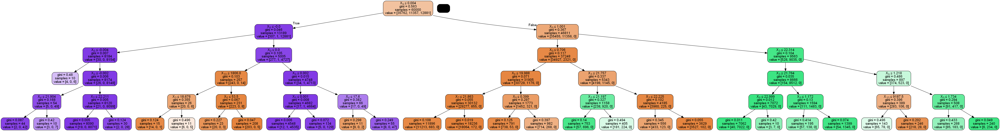

In [44]:
utils9.display_tree(dt_2)

#### Training a smaller tree with max_depth=5, min_impurity_decrease=0.1

In [45]:
dt_3 = DecisionTreeClassifier(max_depth=5, min_impurity_decrease=0.1)
dt_3.fit(x_train, y_train)
print("Training accuracy:", dt_3.score(x_train, y_train))

Training accuracy: 0.9473833333333334


In [46]:
print("Validation accuracy:", dt_3.score(x_valid, y_valid))

Validation accuracy: 0.9486


In [47]:
y_pred_3 = dt_3.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test,y_pred_3))

Testing Accuracy: 0.946


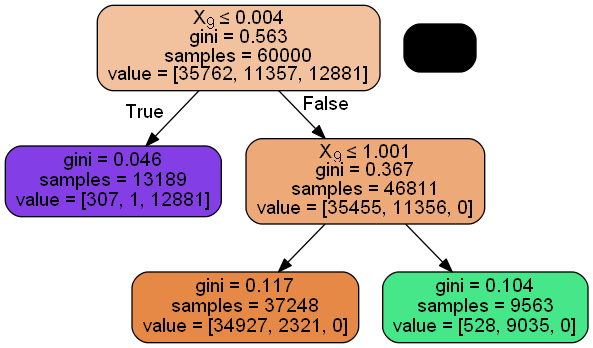

In [48]:
utils9.display_tree(dt_3)

#### Training a smaller tree with max_depth=7, min_samples_leaf=10, min_samples_split=10

In [49]:
dt_4 = DecisionTreeClassifier(max_depth=7, min_samples_leaf=10, min_samples_split=10)
dt_4.fit(x_train, y_train)
print("Training accuracy:", dt_4.score(x_train, y_train))

Training accuracy: 0.9761833333333333


In [50]:
print("Validation accuracy:", dt_4.score(x_valid, y_valid))

Validation accuracy: 0.97425


In [51]:
y_pred_4 = dt_4.predict(x_test)
print("Testing accuracy: ", accuracy_score(y_test,y_pred_4))

Testing accuracy:  0.9734


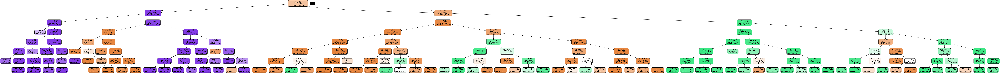

In [52]:
utils9.display_tree(dt_4)

#### Training a smaller tree with max_features=5, max_depth=14

In [53]:
dt_5 = DecisionTreeClassifier(max_features=5, max_depth=14)
dt_5.fit(x_train, y_train)
print("Training accuracy:", dt_5.score(x_train, y_train))

Training accuracy: 0.99145


In [54]:
print("Validation accuracy:", dt_5.score(x_valid, y_valid))

Validation accuracy: 0.9665


In [55]:
y_pred_5 = dt_5.predict(x_test)
print("Testing accuracy: ", accuracy_score(y_test,y_pred_5))

Testing accuracy:  0.9664


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.39217 to fit



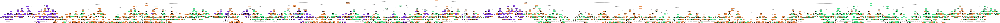

In [56]:
utils9.display_tree(dt_5)

#### Training a smaller tree with max_depth=14, min_samples_leaf=10, min_samples_split=10

In [57]:
dt_6 = DecisionTreeClassifier(max_depth=14, min_samples_leaf=10, min_samples_split=10)
dt_6.fit(x_train, y_train)
print("Training accuracy:", dt_6.score(x_train, y_train))

Training accuracy: 0.9824833333333334


In [58]:
print("Validation accuracy:", dt_6.score(x_valid, y_valid))

Validation accuracy: 0.9748


In [59]:
y_pred_6 = dt_6.predict(x_test)
print("Testing accuracy:", accuracy_score(y_test,y_pred_6))

Testing accuracy: 0.97445


In [60]:
utils9.display_tree(dt_6)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.830954 to fit



#### Training a smaller tree with max_features=5, max_depth=14, min_samples_leaf=10, min_samples_split=10

In [61]:
dt_7 = DecisionTreeClassifier(max_features=5, max_depth=14, min_samples_leaf=10, min_samples_split=10)
dt_7.fit(x_train, y_train)
print("Training accuracy:", dt_7.score(x_train, y_train))

Training accuracy: 0.97305


In [62]:
print("Validation accuracy:", dt_7.score(x_valid, y_valid))

Validation accuracy: 0.9646


In [63]:
y_pred_7 = dt_7.predict(x_test)
print("Testing accuracy: ", accuracy_score(y_test,y_pred_7))

Testing accuracy:  0.9627


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.542761 to fit



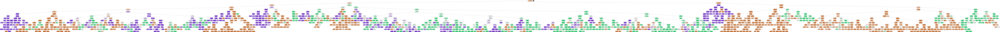

In [64]:
utils9.display_tree(dt_7)

#### Training a smaller tree with max_features=5, max_depth=18, min_samples_leaf=10, min_samples_split=10

In [65]:
dt_8 = DecisionTreeClassifier(max_features=5, max_depth=18, min_samples_leaf=10, min_samples_split=10)
dt_8.fit(x_train, y_train)
print("Training accuracy:", dt_8.score(x_train, y_train))

Training accuracy: 0.9786166666666667


In [66]:
print("Validation accuracy:", dt_8.score(x_valid, y_valid))

Validation accuracy: 0.97095


In [67]:
y_pred_8 = dt_8.predict(x_test)
print("Testing accuracy:", accuracy_score(y_test,y_pred_8))

Testing accuracy: 0.96915


In [68]:
utils9.display_tree(dt_8)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.707207 to fit



In [69]:
dt_9 = DecisionTreeClassifier(criterion='entropy', max_depth=14, min_impurity_decrease=0.3)
dt_9.fit(x_train, y_train)
print("Training accuracy:", dt_9.score(x_train, y_train))

Training accuracy: 0.9473833333333334


In [70]:
print("Validation accuracy:", dt_9.score(x_valid, y_valid))

Validation accuracy: 0.9486


In [71]:
y_pred_9 = dt_9.predict(x_test)
print("Testing accuracy: ", accuracy_score(y_test,y_pred_9))

Testing accuracy:  0.946


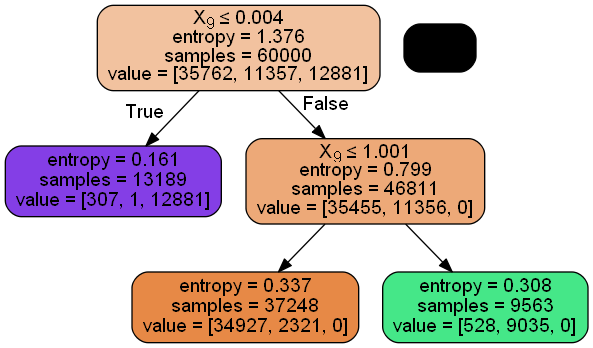

In [72]:
utils9.display_tree(dt_9)

## Comparision

| Model | criterion | max_depth | max_features | min_impurity_decrease | min_samples_leaf | min_samples_split | Training Accuracy | Validation Accuracy | Testing Accuracy |
| :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: |
| dt | gini | - | - | - | - | - | 1.0 | 0.9657 | 0.9648 |
| dt_entropy | entropy | - | - | - | - | - | 1.0 | 0.9649 | 0.9663 |
| dt_1 | gini | 4 | - | - | 10 | 10 | 0.9655 | 0.9657 | 0.9654 | 
| dt_2 | gini | 5 | - | - | 10 | 10 | 0.9659 | 0.9659 | 0.9662 | 
| dt_3 | gini | 5 | - | 0.1 | - | - | 0.9474 | 0.9486 | 0.9460 | 
| dt_4 | gini | 7 | - | - | 10 | 10 | 0.9762 | 0.9743 | 0.9734 | 
| dt_5 | gini | 14 | 5 | - | - | - | 0.9915 | 0.9665 | 0.9664 | 
| dt_6 | gini | 14 | - | - | 10 | 10 | 0.9825 | 0.9748 | 0.9745 | 
| dt_7 | gini | 14 | 5 | - | 10 | 10 | 0.9731 | 0.9646 | 0.9627 | 
| dt_8 | gini | 18 | 5 | - | 10 | 10 | 0.9786 | 0.9710 | 0.9692 | 
| dt_9 | entropy | 14 | - | 0.3 | - | - | 0.9474 | 0.9487 | 0.9460 | 

After experimented with several decision tree models, varying their hyperparameters such as splitting criterion, maximum depth, maximum features, minimum impurity decrease, minimum samples leaf, and minimum samples split, we found that the training accuracy of all the models is high, indicating that the models have learned the training data well. 

Model dt_1 to model dt_8 both training with gini criterion. Notice for model dt_3, we set the max_depth=5 and min_impurity_decrease as 0.1. However, the decision tree stops at depth of 2 when gini is equal to 0.104. The model ends up with an accuracy score of 0.9474, which is the worst compared with other models. Therefore, setting an impurity threshold is not a good choice to help improve the performance of our training.

Model dt2, dt3, and dt6 have the same setting for min_samples_leaf and min_samples_split but different values for the max_depth. As we can see from the table above, when max_depth of 14, it generates a better performance of accuracy. Model dt_7 and dt_8 are compared with max_depth but the model is done similarly after the depth of 14 so we test out how the model performs with max_depth of 14 on model dt_5 to dt_7. The model dt_5 seems to achieve the best performance on training with a training accuracy of 0.9915. The model is set with the max_depth of 14, max_features of _5, min_samples_leaf(default=1), and min_samples_split(default=2).

Based on the validation accuracy, the best model appears to be dt_6, which has a validation accuracy of 0.9748. This model uses gini as the splitting criterion, a maximum depth of 14, and a minimum number of samples required to split of 10. The training accuracy of this model is also high at 0.9825, which suggests that the model is not overfitting the training data.

# Part 2: Support Vector Machines

## Import Modules

In [1]:
import pandas as pd
import seaborn as sns
#from sklearn.svm import SVC
from sklearnex.svm import SVC
import utils11
from sklearn import model_selection as ms
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

In [2]:
# Intel Extension for Scikit-learn to speed up Scikit-learn application performance
from sklearnex import patch_sklearn 
patch_sklearn()

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


## Load and Read Data

In [3]:
data = pd.read_csv("star_classification.csv")
data

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,class,redshift,plate,MJD,fiber_ID
0,1.237661e+18,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,301,2,79,6.543777e+18,GALAXY,0.634794,5812,56354,171
1,1.237665e+18,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,301,5,119,1.176014e+19,GALAXY,0.779136,10445,58158,427
2,1.237661e+18,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,301,2,120,5.152200e+18,GALAXY,0.644195,4576,55592,299
3,1.237663e+18,338.741038,-0.402828,22.13682,23.77656,21.61162,20.50454,19.25010,4192,301,3,214,1.030107e+19,GALAXY,0.932346,9149,58039,775
4,1.237680e+18,345.282593,21.183866,19.43718,17.58028,16.49747,15.97711,15.54461,8102,301,3,137,6.891865e+18,GALAXY,0.116123,6121,56187,842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,1.237679e+18,39.620709,-2.594074,22.16759,22.97586,21.90404,21.30548,20.73569,7778,301,2,581,1.055431e+19,GALAXY,0.000000,9374,57749,438
99996,1.237679e+18,29.493819,19.798874,22.69118,22.38628,20.45003,19.75759,19.41526,7917,301,1,289,8.586351e+18,GALAXY,0.404895,7626,56934,866
99997,1.237668e+18,224.587407,15.700707,21.16916,19.26997,18.20428,17.69034,17.35221,5314,301,4,308,3.112008e+18,GALAXY,0.143366,2764,54535,74
99998,1.237661e+18,212.268621,46.660365,25.35039,21.63757,19.91386,19.07254,18.62482,3650,301,4,131,7.601080e+18,GALAXY,0.455040,6751,56368,470


## Data Cleaning

In [4]:
data = data.drop(['obj_ID', 'rerun_ID', 'spec_obj_ID', 'cam_col'], axis=1)
data

,alpha,delta,u,g,r,i,z,run_ID,field_ID,class,redshift,plate,MJD,fiber_ID
0,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,79,GALAXY,0.634794,5812,56354,171
1,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,119,GALAXY,0.779136,10445,58158,427
2,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,120,GALAXY,0.644195,4576,55592,299
3,338.741038,-0.402828,22.13682,23.77656,21.61162,20.50454,19.25010,4192,214,GALAXY,0.932346,9149,58039,775
4,345.282593,21.183866,19.43718,17.58028,16.49747,15.97711,15.54461,8102,137,GALAXY,0.116123,6121,56187,842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,39.620709,-2.594074,22.16759,22.97586,21.90404,21.30548,20.73569,7778,581,GALAXY,0.000000,9374,57749,438
99996,29.493819,19.798874,22.69118,22.38628,20.45003,19.75759,19.41526,7917,289,GALAXY,0.404895,7626,56934,866
99997,224.587407,15.700707,21.16916,19.26997,18.20428,17.69034,17.35221,5314,308,GALAXY,0.143366,2764,54535,74
99998,212.268621,46.660365,25.35039,21.63757,19.91386,19.07254,18.62482,3650,131,GALAXY,0.455040,6751,56368,470


In [5]:
x = data.drop(['class'], axis=1)
y = data['class']

## Data Scaling

Scaling of the data to have unit norm, data will be in a new range of 0 and 1. 

In [6]:
# MinMaxScaler
#from sklearn.preprocessing import MinMaxScaler

#scaler = MinMaxScaler()
#x = scaler.fit_transform(x)

#StandardScaler
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(x)
x = scaler.transform(x)
print(x)

[[-0.43460358  0.42552871  0.0597546  ...  0.22863291  0.42320321
  -1.02134224]
 [-0.33992143  0.36340227  0.08804527 ...  1.79792394  1.42072864
  -0.0818825 ]
 [-0.36725058  0.58271274  0.10332677 ... -0.19002535  0.00185377
  -0.55161237]
 ...
 [ 0.48660555 -0.4293603  -0.02553763 ... -0.80378648 -0.58261651
  -1.37730941]
 [ 0.35895206  1.14663054  0.10607535 ...  0.54669125  0.43094454
   0.07591737]
 [ 0.19965373  1.28938133  0.02018443 ...  0.76990791  0.83791722
   1.47409769]]


Note: StandardScaler is useful for features that follow a Normal distribution. MinMaxScaler may be used when the upper and lower boundaries are well known from domain knowledge. Retrieved from: https://datascience.stackexchange.com/questions/43972/when-should-i-use-standardscaler-and-when-minmaxscaler

## Data Split

In [7]:
#small size data
#x_train, x_test, y_train, y_test = ms.train_test_split(x, y, test_size=0.9, random_state=0)

#Training/Validation/Testing Split: 60, 20, 20
x_train, x_test, y_train, y_test = ms.train_test_split(x, y, test_size=0.4, random_state=0)
x_test, x_valid, y_test, y_valid = ms.train_test_split(x_test, y_test, test_size=0.5, random_state=0)

#Training/Validation/Testing Split: 80, 10, 10
#x_train, x_test, y_train, y_test = ms.train_test_split(x, y, test_size=0.2, random_state=0)
#x_test, x_valid, y_test, y_valid = ms.train_test_split(x_test, y_test, test_size=0.5, random_state=0)


In [8]:
x_train.shape

(60000, 13)

# SVM 

# Building Linear kernels

In [9]:
svm_linear = SVC(kernel='linear')
svm_linear.fit(x_train,y_train)

SVC(kernel='linear')

In [10]:
print("Training Accuracy:", svm_linear.score(x_train, y_train))

Training Accuracy: 0.9613833333333334


In [11]:
print("Validation Accuracy:", svm_linear.score(x_valid, y_valid))

Validation Accuracy: 0.96195


In [12]:
pred_linear = svm_linear.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_linear))

Testing Accuracy: 0.9592


## One-versus-one & One-versus-rest for multiclass problem

When implemented with "one-versus-one" for the multiclass problem, n_classes * (n_classes - 1) / 2 classifiers are constructed and each one will be trained from two classes. Data will be split into binary sets for training. In this project, three classes{GALAXY, STAR, QSO} will be split into {GALAXY, STAR}, {GALAXY, QSO}, {STAR, QSO}. SVM model will loop through for each set, then each SVM gets a vote and the majority vote will win. 

In [45]:
svm_linear_ovo = SVC(kernel='linear', decision_function_shape='ovo')
svm_linear_ovo.fit(x_train,y_train)
print("linear kernel with one-versus-one")
print("Training Accuracy:", svm_linear_ovo.score(x_train, y_train))
print("Validation Accuracy:", svm_linear_ovo.score(x_valid, y_valid))
pred_linear_ovo = svm_linear_ovo.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_linear_ovo))

linear kernel with one-versus-one
Training Accuracy: 0.9613833333333334
Validation Accuracy: 0.96195
Testing Accuracy: 0.9592


In [54]:
# decision_function of shape(n_samples, n_classes)
dec_ovo = svm_linear_ovo.decision_function(x_train)
dec_ovo.shape[1] # 3 classes: 3*2/2 = 3

3

When implement with "one-versus-rest" for the multiclass problem, the number of SVM models needed will be based on the number of classes. In this project, there are three classes(GALAXY, STAR, QSO). When training, each SVM is labelled as class 'i' or not class 'i'. For example, when handling the class of "GALAXY", the SVM training label the "STAR" and the "QSO" as "NOT GALAXY". SVM evaluates with a score for prediction, the SVM with the highest score will win.

In [46]:
svm_linear_ovr = SVC(kernel='linear', decision_function_shape='ovr')
svm_linear_ovr.fit(x_train,y_train)
print("linear kernel with one-versus-rest")
print("Training Accuracy:", svm_linear_ovr.score(x_train, y_train))
print("Validation Accuracy:", svm_linear_ovr.score(x_valid, y_valid))
pred_linear_ovr = svm_linear_ovr.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_linear_ovr))

linear kernel with one-versus-rest
Training Accuracy: 0.9613833333333334
Validation Accuracy: 0.96195
Testing Accuracy: 0.9592


In [50]:
dec_ovr = svm_linear_ovr.decision_function(x_train)
dec_ovr.shape[1] # 3 classes

3

Note: this project will use the default sklearn setting for multiclass, which is "one-verus-rest"

## C parameter

C parameter: It controls whether we want to train our SVM model that pays more attention to classification than to distance. It controls the degree of correct classification that the SVM model has to meet. The Error formula = C * (Classification Error) + (Distance Error), our classifier focuses more on classifying the points correctly when the C parameter is large. Conversely, a smaller C parameter means we want our classifier focuses more on keeping the distance of the two parallel lines far apart.  

## Building with C parameter 0.01

In [13]:
# C = 0.01
svm_c_001 = SVC(kernel='linear', C=0.01)
svm_c_001.fit(x_train, y_train)
print("C = 0.01")
print("Training Accuracy:", svm_c_001.score(x_train, y_train))
print("Validation Accuracy:", svm_c_001.score(x_valid, y_valid))

pred_c_001 = svm_c_001.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_c_001))

C = 0.01
Training Accuracy: 0.93695
Validation Accuracy: 0.94145
Testing Accuracy: 0.9352


## Building with C parameter 0.1

In [14]:
# C = 0.1
svm_c_01 = SVC(kernel='linear', C=0.1)
svm_c_01.fit(x_train, y_train)
print("C = 0.1")
print("Training Accuracy:", svm_c_01.score(x_train, y_train))
print("Validation Accuracy:", svm_c_01.score(x_valid, y_valid))

pred_c_01 = svm_c_01.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_c_01))

C = 0.1
Training Accuracy: 0.9496833333333333
Validation Accuracy: 0.95065
Testing Accuracy: 0.9476


## Building with C parameter 1

In [15]:
# C = 1
svm_c_1 = SVC(kernel='linear', C=1)
svm_c_1.fit(x_train, y_train)
print("C = 1")
print("Training Accuracy:", svm_c_1.score(x_train, y_train))
print("Validation Accuracy:", svm_c_1.score(x_valid, y_valid))

pred_c_1 = svm_c_1.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_c_1))

C = 1
Training Accuracy: 0.9613833333333334
Validation Accuracy: 0.96195
Testing Accuracy: 0.9592


## Building with C parameter 100

In [16]:
# C = 100
svm_c_100 = SVC(kernel='linear', C=100)
svm_c_100.fit(x_train, y_train)
print("C = 100")
print("Training Accuracy:", svm_c_100.score(x_train, y_train))
print("Validation Accuracy:", svm_c_100.score(x_valid, y_valid))

pred_c_100 = svm_c_100.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_c_100))

C = 100
Training Accuracy: 0.9644333333333334
Validation Accuracy: 0.965
Testing Accuracy: 0.9629


## Building with C parameter 1000

In [17]:
# C = 1000
svm_c_1000 = SVC(kernel='linear', C=1000)
svm_c_1000.fit(x_train, y_train)
print("C = 1000")
print("Training Accuracy:", svm_c_1000.score(x_train, y_train))
print("Validation Accuracy:", svm_c_1000.score(x_valid, y_valid))

pred_c_1000 = svm_c_1000.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_c_1000))

C = 1000
Training Accuracy: 0.9646
Validation Accuracy: 0.96535
Testing Accuracy: 0.9632


# Building Polynomial kernels

In [18]:
# poly 
svm_poly = SVC(kernel='poly')
svm_poly.fit(x_train, y_train)
print("Polynomial kernel")
print("Training Accuracy:", svm_poly.score(x_train, y_train))
print("Validation Accuracy:", svm_poly.score(x_valid, y_valid))

pred_poly = svm_poly.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_poly))

Polynomial kernel
Training Accuracy: 0.9236333333333333
Validation Accuracy: 0.9261
Testing Accuracy: 0.9204


In [19]:
# Degree = 2
svm_poly_2 = SVC(kernel='poly', degree=2)
svm_poly_2.fit(x_train, y_train)
print("Polynomial kernel of degree = 2")
print("Training Accuracy:", svm_poly_2.score(x_train, y_train))
print("Validation Accuracy:", svm_poly_2.score(x_valid, y_valid))

pred_poly_2 = svm_poly_2.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_poly_2))

Polynomial kernel of degree = 2
Training Accuracy: 0.9121666666666667
Validation Accuracy: 0.9143
Testing Accuracy: 0.91015


In [20]:
# Degree = 5
svm_poly_5 = SVC(kernel='poly', degree=5)
svm_poly_5.fit(x_train, y_train)
print("Polynomial kernel of degree = 5")
print("Training Accuracy:", svm_poly_5.score(x_train, y_train))
print("Validation Accuracy:", svm_poly_5.score(x_valid, y_valid))

pred_poly_5 = svm_poly_5.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_poly_5))

Polynomial kernel of degree = 5
Training Accuracy: 0.9044833333333333
Validation Accuracy: 0.8981
Testing Accuracy: 0.8963


In [21]:
# Degree = 10
svm_poly_10 = SVC(kernel='poly', degree=10)
svm_poly_10.fit(x_train, y_train)
print("Polynomial kernel of degree = 10")
print("Training Accuracy:", svm_poly_10.score(x_train, y_train))
print("Validation Accuracy:", svm_poly_10.score(x_valid, y_valid))

pred_poly_10 = svm_poly_10.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_poly_10))

Polynomial kernel of degree = 10
Training Accuracy: 0.8537666666666667
Validation Accuracy: 0.8335
Testing Accuracy: 0.83325


# Building Radial Basis Functions(rbf) kernels

In [22]:
svm_rbf = SVC(kernel='rbf')
svm_rbf.fit(x_train, y_train)
print("rbf kernel")
print("Training Accuracy:", svm_rbf.score(x_train, y_train))
print("Validation Accuracy:", svm_rbf.score(x_valid, y_valid))

pred_rbf = svm_rbf.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_rbf))

rbf kernel
Training Accuracy: 0.9583333333333334
Validation Accuracy: 0.9575
Testing Accuracy: 0.95555


In [43]:
svm_rbf_ovo = SVC(kernel='rbf', decision_function_shape='ovo')
svm_rbf_ovo.fit(x_train, y_train)
print("rbf kernel with one-versus-one")
print("Training Accuracy:", svm_rbf_ovo.score(x_train, y_train))
print("Validation Accuracy:", svm_rbf_ovo.score(x_valid, y_valid))

pred_rbf_ovo = svm_rbf_ovo.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_rbf_ovo))

rbf kernel with one-versus-one
Training Accuracy: 0.9583333333333334
Validation Accuracy: 0.9575
Testing Accuracy: 0.95555


In [44]:
svm_rbf_ovr = SVC(kernel='rbf', decision_function_shape='ovr')
svm_rbf_ovr.fit(x_train, y_train)
print("rbf kernel with one-versus-rest")
print("Training Accuracy:", svm_rbf_ovr.score(x_train, y_train))
print("Validation Accuracy:", svm_rbf_ovr.score(x_valid, y_valid))

pred_rbf_ovr = svm_rbf_ovr.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_rbf_ovr))

rbf kernel with one-versus-rest
Training Accuracy: 0.9583333333333334
Validation Accuracy: 0.9575
Testing Accuracy: 0.95555


## Experimenting with gammas in the rbf kernel

In [23]:
# gamma = 0.01
svm_gamma_001 = SVC(kernel='rbf', gamma=0.01)
svm_gamma_001.fit(x_train, y_train)
print("rbf kernel of Gamma = 0.01")
print("Training Accuracy:", svm_gamma_001.score(x_train, y_train))
print("Validation Accuracy:", svm_gamma_001.score(x_valid, y_valid))

pred_gamma_001 = svm_gamma_001.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_gamma_001))

rbf kernel of Gamma = 0.01
Training Accuracy: 0.9463
Validation Accuracy: 0.94855
Testing Accuracy: 0.94455


In [24]:
# gamma = 0.1
svm_gamma_01 = SVC(kernel='rbf', gamma=0.1)
svm_gamma_01.fit(x_train, y_train)
print("rbf kernel of Gamma = 0.1")
print("Training Accuracy:", svm_gamma_01.score(x_train, y_train))
print("Validation Accuracy:", svm_gamma_01.score(x_valid, y_valid))

pred_gamma_01 = svm_gamma_01.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_gamma_01))

rbf kernel of Gamma = 0.1
Training Accuracy: 0.95835
Validation Accuracy: 0.9575
Testing Accuracy: 0.95555


In [25]:
# gamma = 1
svm_gamma_1 = SVC(kernel='rbf', gamma=1)
svm_gamma_1.fit(x_train, y_train)
print("rbf kernel of Gamma = 1")
print("Training Accuracy:", svm_gamma_1.score(x_train, y_train))
print("Validation Accuracy:", svm_gamma_1.score(x_valid, y_valid))

pred_gamma_1 = svm_gamma_1.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_gamma_1))

rbf kernel of Gamma = 1
Training Accuracy: 0.9632833333333334
Validation Accuracy: 0.9443
Testing Accuracy: 0.9413


In [26]:
# gamma = 10
svm_gamma_10 = SVC(kernel='rbf', gamma=10)
svm_gamma_10.fit(x_train, y_train)
print("rbf kernel of Gamma = 10")
print("Training Accuracy:", svm_gamma_10.score(x_train, y_train))
print("Validation Accuracy:", svm_gamma_10.score(x_valid, y_valid))

pred_gamma_10 = svm_gamma_10.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_gamma_10))

rbf kernel of Gamma = 10
Training Accuracy: 0.9943666666666666
Validation Accuracy: 0.70905
Testing Accuracy: 0.702


In [27]:
# gamma = 100
svm_gamma_100 = SVC(kernel='rbf', gamma=100)
svm_gamma_100.fit(x_train, y_train)
print("rbf kernel of Gamma = 100")
print("Training Accuracy:", svm_gamma_100.score(x_train, y_train))
print("Validation Accuracy:", svm_gamma_100.score(x_valid, y_valid))

pred_gamma_100 = svm_gamma_100.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_gamma_100))

rbf kernel of Gamma = 100
Training Accuracy: 0.99995
Validation Accuracy: 0.6011
Testing Accuracy: 0.5962


In [28]:
# gamma = 1 & c = 100
svm_gamma_1_c100 = SVC(kernel='rbf', gamma=1,  C=100)
svm_gamma_1_c100.fit(x_train, y_train)
print("rbf kernel of Gamma = 1 & C = 100")
print("Training Accuracy:", svm_gamma_1_c100.score(x_train, y_train))
print("Validation Accuracy:", svm_gamma_1_c100.score(x_valid, y_valid))

pred_gamma_1_c100 = svm_gamma_1_c100.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_gamma_1_c100))

rbf kernel of Gamma = 1 & C = 100
Training Accuracy: 0.9990166666666667
Validation Accuracy: 0.939
Testing Accuracy: 0.93435


In [29]:
# rbf with c = 100
svm_rbf_c100 = SVC(kernel='rbf', C=100)
svm_rbf_c100.fit(x_train, y_train)
print("rbf kernel of C = 100")
print("Training Accuracy:", svm_rbf_c100.score(x_train, y_train))
print("Validation Accuracy:", svm_rbf_c100.score(x_valid, y_valid))

pred_rbf_c100 = svm_rbf_c100.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_rbf_c100))

rbf kernel of C = 100
Training Accuracy: 0.9771
Validation Accuracy: 0.9702
Testing Accuracy: 0.96875


In [36]:
# rbf with c = 1000
svm_rbf_c1000 = SVC(kernel='rbf', C=1000)
svm_rbf_c1000.fit(x_train, y_train)
print("rbf kernel of C = 1000")
print("Training Accuracy:", svm_rbf_c1000.score(x_train, y_train))
print("Validation Accuracy:", svm_rbf_c1000.score(x_valid, y_valid))

pred_rbf_c1000 = svm_rbf_c1000.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_rbf_c1000))

rbf kernel of C = 1000
Training Accuracy: 0.9835666666666667
Validation Accuracy: 0.96765
Testing Accuracy: 0.96605


In [42]:
# gamma = 1 & c = 1000
svm_gamma_1_c1000 = SVC(kernel='rbf', gamma=1,  C=1000)
svm_gamma_1_c1000.fit(x_train, y_train)
print("rbf kernel of Gamma = 1 & C = 1000")
print("Training Accuracy:", svm_gamma_1_c1000.score(x_train, y_train))
print("Validation Accuracy:", svm_gamma_1_c1000.score(x_valid, y_valid))

pred_gamma_1_c1000 = svm_gamma_1_c1000.predict(x_test)
print("Testing Accuracy:", accuracy_score(y_test, pred_gamma_1_c1000))

rbf kernel of Gamma = 1 & C = 1000
Training Accuracy: 1.0
Validation Accuracy: 0.9351
Testing Accuracy: 0.9307


In [56]:
print(classification_report(y_test, pred_gamma_1_c1000))

              precision    recall  f1-score   support

      GALAXY       0.94      0.95      0.94     11797
         QSO       0.90      0.88      0.89      3826
        STAR       0.93      0.94      0.93      4377

    accuracy                           0.93     20000
   macro avg       0.92      0.92      0.92     20000
weighted avg       0.93      0.93      0.93     20000



<AxesSubplot:>

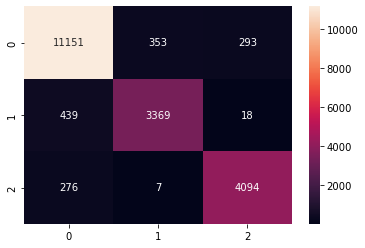

In [58]:
cm = confusion_matrix(y_test, pred_gamma_1_c1000)
sns.heatmap(cm, annot=True, fmt=".0f")

## Comparision

| Model | kernel | c | degree | gamma | Training Accuracy | Validation Accuracy | Testing Accuracy |
| :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: | 
| svm_linear | linear | - | - | - | 0.9614 | 0.9620 | 0.9592 |
| svm_c_001 | linear | 0.01 | - | - | 0.9370 | 0.9415 | 0.9352 |
| svm_c_01 | linear | 0.1 | - | - | 0.9497 | 0.9507 | 0.9476 | 
| svm_c_1 | linear | 1 | - | - | 0.9614 | 0.9620 | 0.9592 | 
| svm_c_100 | linear | 100 | - | - | 0.9644 | 0.9650 | 0.9629 | 
| svm_c_1000 | linear | 1000 | - | - | 0.9646 | 0.9654 | 0.9632 | 
| svm_poly | poly | - | - | - | 0.9236 | 0.9261 | 0.9204 | 
| svm_poly_2 | poly | - | 2 | - | 0.9122 | 0.9143 | 0.9102 | 
| svm_poly_5 | poly | - | 5 | - | 0.9045 | 0.8981 | 0.8963 | 
| svm_poly_10 | poly | - | 10 | - | 0.8538 | 0.8335 | 0.8333 |
| svm_rbf | rbf | - | - | - | 0.9583 | 0.9575 | 0.9556 | 
| svm_gamma_001 | rbf | - | - | 0.01 | 0.9463 | 0.9486 | 0.9446 | 
| svm_gamma_01 | rbf | - | - | 0.1 | 0.9584 | 0.9575 | 0.9556 | 
| svm_gamma_1 | rbf | - | - | 1 | 0.9633 | 0.9443 | 0.9413 | 
| svm_gamma_10 | rbf | - | - | 10 | 0.9944 | 0.7091 | 0.7020 |
| svm_gamma_100 | rbf | - | - | 100 | 1.0000 | 0.6011 | 0.5962 | 
| svm_gamma_1_c100 | rbf | 100 | - | 1 | 0.9990 | 0.9390 | 0.9344 | 
| svm_rbf_c100 | rbf | 100 | - | - | 0.9771 | 0.9702 | 0.9688 | 
| svm_rbf_c1000 | rbf | 1000 | - | - | 0.9836 | 0.9680 | 0.9661 | 
| svm_gamma_1_c1000 | rbf | 1000 | - | 1 | 1.0000 | 0.9351 | 0.9307 | 

From the summary table above, we can see that different hyperparameters significantly affect the performance of the SVM model on star classification. It is important to note that the SVM with an RBF kernel and a gamma of 10 (svm_gamma_10) and 100 (svm_gamma_100) have very high training accuracies of 0.9944 and 1.0000, respectively, but much lower validation and testing accuracies. This suggests that the model may be overfitting the training data and may not perform as well on new data. Different values of gamma tend to be overfit and underfit. When using the radial basis function, it lifts the plane at a point and with a high gamma it lifts a point with a narrow surface but others with a wide surface. High gamma tends to be overfitting. As we can see from the table above, the two models with gamma 10 and gamma 100 both did well on training but did poorly on validation. 

Overall, the rbf kernel has the best performance since some models with a higher c-parameter achieve an accuracy of over 97%. The polynomial kernel has the worst performance compared with the other two kernels. The linear kernel has an average of 96% accuracy on both training and validation. The accuracy is increased with a higher c parameter.

The rbf kernel gets better with gamma higher than one, but overfitting when gamma is set to be 10 or 100. The rbf kernel models with a c-parameter of 100 or 1000 both did very well on both training and validation.Based on the validation accuracy results, the best SVM model for classifying stars, galaxies, and quasars would be the SVM with the RBF kernel and a c-parameter of 1000 (svm_rbf_c1000). This model achieved the highest validation accuracy of 0.9680, and it provides the best balance between model complexity and performance on new data. 

## Comparsion between decision tree and SVM

| Model | criterion | kernel | max_depth | min_samples_leaf | min_samples_split | c | Training Accuracy | Validation Accuracy | Testing Accuracy |
| :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: |
| dt_6 | gini | - | 14 | 10 | 10 | - |0.9825 | 0.9748 | 0.9745 | 
| svm_rbf_c1000 | -| rbf | -| -| -| 1000 | 0.9836 | 0.9680 | 0.9661 |

From the table above, it seems that both the decision tree (dt_6) and SVM (svm_rbf_c1000) models are performing quite well on this classification task, with both achieving high training, validation, and testing accuracies. It appears that the decision tree Model dt_6 has slightly higher validation accuracy compared to the SVM Model svm_rbf_c1000, suggesting that it may be the better model for this classification task. 